In [1]:
#!pip install qiskit
#!pip install matplotlib
#!pip install pylatexenc

In [3]:
import qiskit
from qiskit import assemble, transpile
from qiskit import QuantumCircuit, ClassicalRegister, QuantumRegister
import qiskit.ignis.verification.quantum_volume as qv

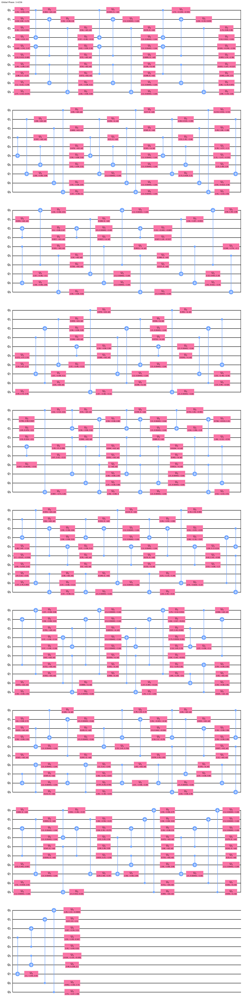

In [4]:
# qubit_lists: QV回路を生成するための量子ビットサブセットのリストのリスト
nqubits = 10
qubit_lists = [[i for i in range(nqubits)]]
# ntrials: サブセットごとに作成するランダム回路の数
ntrials = 1

import warnings
warnings.filterwarnings('ignore')
qv_circs, qv_circs_nomeas = qv.qv_circuits(qubit_lists, ntrials)

qv_circs_nomeas[0] = qiskit.compiler.transpile(qv_circs_nomeas[0], basis_gates=['u1','u2','u3','cx'])
qv_circs_nomeas[0][0].draw(output='mpl')


In [5]:
f = open('hoge.qasm', 'w')
f.write(qv_circs_nomeas[0][0].qasm())
f.close()

# 課題４成果物デモンストレーション
## ・量子コンピュータ、初心者のための教育用GUI https://qulacs-gui.github.io/qulacs-simulator/ 
## ・高速シミュレータQulacsを用いたシミュレータバックエンド
## ・量子コンピュータ実機制約を満たしたQASMへと回路変換するトランスパイラ

# Qulacsを用いたシミュレータバックエンド

シミュレータバックエンドの種類
- ideal simulator with sampling
- ideal calculation of observable 
- estimation of observable with ideal sampling (with shot noise)
- noise simulator (sampling, observable calculation, observable estimation with sampling) 

In [35]:
f = open('hoge.qasm', 'r')
hoge_qasm = f.read()
f.close()
print(hoge_qasm)

OPENQASM 2.0;
include "qelib1.inc";
qreg q[10];
u3(1.5469288,-2.8277906,2.7270131) q[0];
u3(2.2813222,1.4816381,-1.7218133) q[1];
u3(1.3242354,-1.7983311,0.541192) q[2];
u3(1.6351298,-2.2318667,3.1028801) q[3];
cx q[0],q[3];
u3(0.46365387,-pi/2,pi/2) q[0];
u3(1.5699358,-3.07503,-3.1286844) q[3];
cx q[0],q[3];
u3(0.03025315,0,-pi/2) q[0];
u3(1.5043758,0.0044345716,-1.6375118) q[3];
cx q[0],q[3];
u3(1.7285025,-0.19931365,-0.55479288) q[0];
u3(1.5249933,0.91057055,-3.0124968) q[3];
u3(0.44889372,-2.411138,1.4739187) q[4];
u3(1.5219969,0.5122379,0.48454526) q[5];
cx q[5],q[1];
u3(1.5929573,-3.0788164,2.8026727) q[1];
u3(0.72010473,-pi/2,pi/2) q[5];
cx q[5],q[1];
u3(1.5043758,0.0044345716,-1.6375118) q[1];
u3(0.089450441,0,-pi/2) q[5];
cx q[5],q[1];
u3(1.2805837,-1.0213828,0.69365036) q[1];
u3(0.80533913,1.7392758,-2.9558717) q[5];
cx q[3],q[5];
u3(0.59726811,-pi/2,pi/2) q[3];
u3(1.5790927,-3.0755427,3.0168207) q[5];
cx q[3],q[5];
u3(0.22036353,0,-pi/2) q[3];
u3(1.5043758,0.0044345716,-1.63

## Ideal simulator with sampling

In [36]:
!ouqu-tp ideal simulate --input-qasm-file=hoge.qasm --shots=100

0011100100
1001100100
0101111110
0000111000
1010000000
0011010110
0110111101
1111011010
1000010111
1101111101
0011000100
1001010010
0101111011
0010001011
0011111000
0110001101
0001110101
0111100100
0010001000
0101101010
0101010000
0000010111
0100111001
1010001101
1010001010
0010001111
1000100010
0111111011
1111110010
1111110101
0000110111
1000100011
0110000010
1111101101
1001110110
0111110010
1011101010
1000011001
1010111010
1010001011
0111110010
0000110011
0010100011
0010000110
0011000101
0011110011
1110011101
0111110111
1100001110
0110111101
0100001010
0000111101
0001001000
1011101010
1011101101
0000100001
1101011010
1001001010
1000000000
0010100110
0000110011
0011110101
1001110111
0110001110
0001010011
0011110101
0101110110
0110001111
0111001001
0000001011
0111100011
1011010100
1010000111
0011001110
1110111010
0100110001
1101011011
1100000100
1101000011
0110111101
1010010110
0100110001
1110111000
0011011100
0000000100
0110100000
1010000011
0000001000
1111110010
1000101011
1111001100

## Idela observable calculation
OpenFermion形式でobservableを記述する

In [11]:
observable_openfermion = """(-0.09706626816763086+0j) [] +
(-0.04530261550379928+0j) [X0 X1 Y2 Y3] +
(0.04530261550379928+0j) [X0 Y1 Y2 X3] +
(0.04530261550379928+0j) [Y0 X1 X2 Y3] +
(-0.04530261550379928+0j) [Y0 Y1 X2 X3] +
(0.1714128264477691+0j) [Z0] +
(0.16868898170361213+0j) [Z0 Z1] +
(0.1206252348339042+0j) [Z0 Z2] +
(0.16592785033770346+0j) [Z0 Z3] +
(0.1714128264477692+0j) [Z1] +
(0.16592785033770346+0j) [Z1 Z2] +
(0.1206252348339042+0j) [Z1 Z3] +
(-0.22343153690813464+0j) [Z2] +
(0.17441287612261575+0j) [Z2 Z3] +
(-0.22343153690813466+0j) [Z3]+
(-0.22343153690813466+0j) [Z9]"""

f = open('foo.of', 'w')
f.write(observable_openfermion)
f.close()

In [12]:
!ouqu-tp ideal getval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of

-0.1319437440019187


## Estimation of observable with ideal sampling (with shot noise)
各パウリの項ごとに測定を行い期待値を評価する。

In [13]:
!ouqu-tp ideal sampleval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --shots=100

-0.03719944803605122


In [14]:
!ouqu-tp ideal sampleval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --shots=1000

-0.14253293055280988


In [15]:
!ouqu-tp ideal sampleval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --shots=10000

-0.12848035163919114


In [16]:
!ouqu-tp ideal sampleval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --shots=100000

-0.13094693306442934


In [17]:
!ouqu-tp ideal sampleval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --shots=1000000

-0.13041773801162165


## Noise simulator 
State preparation, measurement, 1 qubit gate, 2 qubitゲートに対してノイズを導入して、上記のsimulationを実行。

In [18]:
prob = 0.01
shots = int(10)
pp= prob # preparation
pm = prob #measurement
p1 = prob # 1Q depolarizing noise
p2 = prob # 2Q depolarizing noise

### Noisy sampling

In [19]:
!ouqu-tp noisy simulate --input-qasm-file=hoge.qasm --shots=$shots --p1=$p1 --p2=$p2 --pm=$pm --pp=$pp

1011111110
0110010010
1001001110
1100001000
1110100100
1111010011
1101001001
0010111111
0001010100
0101111010


### Noisy observable calculation (without sampling)

In [20]:
!ouqu-tp noisy getval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --p1=$p1 --p2=$p2 --pm=$pm --pp=$pp

-0.10143695200881075


### Noisy sampling estimation 

In [22]:
shots = 1000
!ouqu-tp noisy sampleval --input-qasm-file=hoge.qasm --input-openfermion-file=foo.of --shots=$shots --p1=$p1 --p2=$p2 --pm=$pm --pp=$pp

-0.11863618809924222


# 実機の制約条件を満たす量子回路へと変換
サンプルとして、グローバーと位相推定の両方を使う複雑な量子回路について考える。

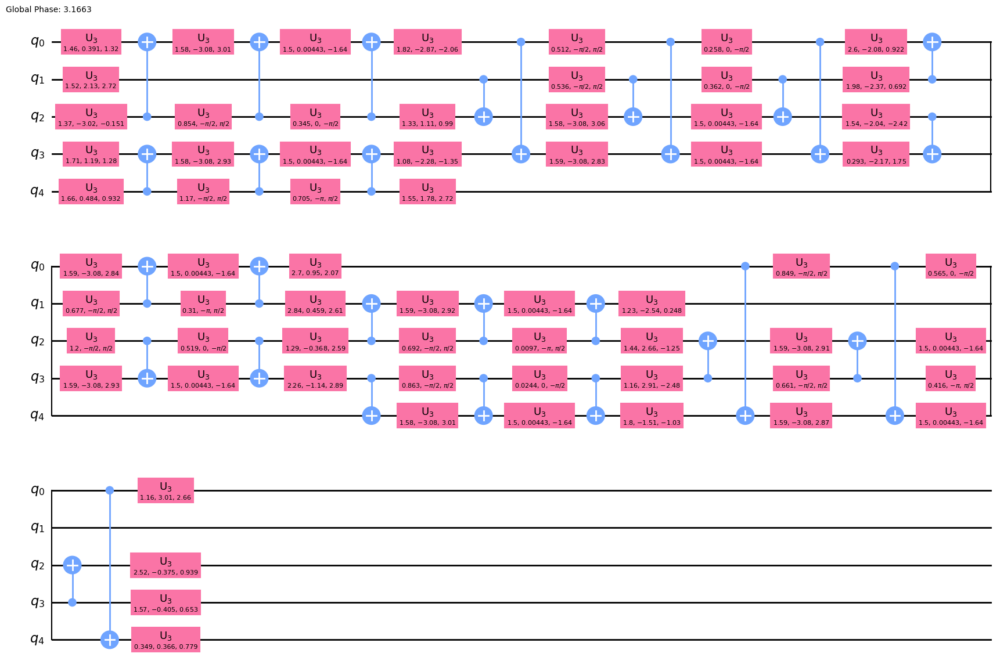

In [23]:
# qubit_lists: QV回路を生成するための量子ビットサブセットのリストのリスト
nqubits =5
qubit_lists = [[i for i in range(nqubits)]]
# ntrials: サブセットごとに作成するランダム回路の数
ntrials = 1

import warnings
warnings.filterwarnings('ignore')
qv_circs, qv_circs_nomeas = qv.qv_circuits(qubit_lists, ntrials)

qv_circs_nomeas[0] = qiskit.compiler.transpile(qv_circs_nomeas[0], basis_gates=['u1','u2','u3','cx'])
qv_circs_nomeas[0][0].draw(output='mpl')

In [24]:
f = open('qv.qasm', 'w')
f.write(qv_circs_nomeas[0][0].qasm())
f.close()

実機制約を満たした回路へと変換

In [25]:
!ouqu-tp trance trance --input-qasm-file=qv.qasm --input-cnot-json-file=ouqu-tp/sample/created_Cnet.json >transpiled_qv.qasm

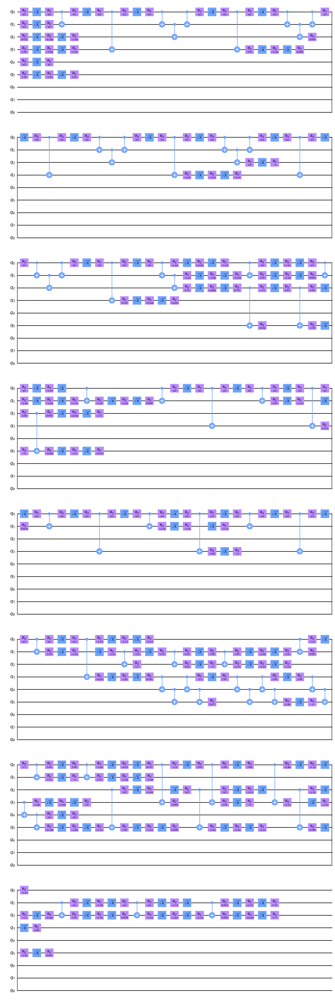

In [26]:
output_circuit =QuantumCircuit.from_qasm_file('transpiled_qv.qasm')
output_circuit.draw(output='mpl')

CNOTの代わりにCrossResonance gateに変換することも可能

In [129]:
!ouqu-tp trance trance_res --input-qasm-file=qv.qasm --input-cnot-json-file=ouqu-tp/sample/created_Cnet.json >transpiled_cr_qv.qasm

## もう少し複雑な量子アルゴリズムのトランスパイル

In [27]:
import matplotlib.pyplot as plt
import numpy as np
import math

# importing Qiskit
import qiskit
from qiskit import QuantumCircuit, transpile, assemble, Aer

# import basic plot tools
from qiskit.visualization import plot_histogram

def example_grover_iteration():
    """Small circuit with 5/16 solutions"""
    # 回路を作る
    qc = QuantumCircuit(4)
    # オラクル
    qc.h([2,3])
    qc.ccx(0,1,2)
    qc.h(2)
    qc.x(2)
    qc.ccx(0,2,3)
    qc.x(2)
    qc.h(3)
    qc.x([1,3])
    qc.h(2)
    qc.mct([0,1,3],2)
    qc.x([1,3])
    qc.h(2)
    # 拡散
    qc.h(range(3))
    qc.x(range(3))
    qc.z(3)
    qc.mct([0,1,2],3)
    qc.x(range(3))
    qc.h(range(3))
    qc.z(3)
    return qc

# 制御されたグローバーの作成
grit = example_grover_iteration().to_gate()
grit.label = "Grover"
cgrit = grit.control()

def qft(n):
    #n量子ビットのQFT回路を作成
    """Creates an n-qubit QFT circuit"""
    circuit = QuantumCircuit(4)
    def swap_registers(circuit, n):
        for qubit in range(n//2):
            circuit.swap(qubit, n-qubit-1)
        return circuit
    def qft_rotations(circuit, n):
        #swapゲートなしで回路で最初にn量子ビットのQFTを実装する
        """Performs qft on the first n qubits in circuit (without swaps)"""
        if n == 0:
            return circuit
        n -= 1
        circuit.h(n)
        for qubit in range(n):
            circuit.cp(np.pi/2**(n-qubit), qubit, n)
        qft_rotations(circuit, n)
    
    qft_rotations(circuit, n)
    swap_registers(circuit, n)
    return circuit

qft_dagger = qft(4).to_gate().inverse()
qft_dagger.label = "QFT†"

# 量子回路の作成
t = 4   # カウントする量子ビットの数
n = 4   # 探索する量子ビットの数
qc = QuantumCircuit(n+t, t) # 古典ビットとn+t量子ビットの回路

# 全ての量子ビットを |+>に初期化する
for qubit in range(t+n):
    qc.h(qubit)

# Begin controlled Grover iterations
iterations = 1
for qubit in range(t):
    for i in range(iterations):
        qc.append(cgrit, [qubit] + [*range(t, n+t)])
    iterations *= 2
    
# Do inverse QFT on counting qubits
qc.append(qft_dagger, range(t))

# Measure counting qubits
qc.measure(range(t), range(t))

# Display the circuit
qc.draw()


┌───┐                                                                  »
q_0: ┤ H ├─────■────────────────────────────────────────────────────────────»
     ├───┤     │                                                            »
q_1: ┤ H ├─────┼──────────■──────────■──────────────────────────────────────»
     ├───┤     │          │          │                                      »
q_2: ┤ H ├─────┼──────────┼──────────┼──────────■──────────■──────────■─────»
     ├───┤     │          │          │          │          │          │     »
q_3: ┤ H ├─────┼──────────┼──────────┼──────────┼──────────┼──────────┼─────»
     ├───┤┌────┴────┐┌────┴────┐┌────┴────┐┌────┴────┐┌────┴────┐┌────┴────┐»
q_4: ┤ H ├┤0        ├┤0        ├┤0        ├┤0        ├┤0        ├┤0        ├»
     ├───┤│         ││         ││         ││         ││         ││         │»
q_5: ┤ H ├┤1        ├┤1        ├┤1        ├┤1        ├┤1        ├┤1        ├»
     ├───┤│  Grover ││  Grover ││  Grover ││  Grover ││  Grover ││  Grover │»
q_6: ┤ H ├┤2        ├┤2        ├┤2        ├┤2        ├┤2        ├┤2        ├»
     ├───┤│         ││         ││         ││         ││         ││         │»
q_7: ┤ H ├┤3        ├┤3        ├┤3        ├┤3        ├┤3        ├┤3        ├»
     └───┘└─────────┘└─────────┘└─────────┘└─────────┘└─────────┘└─────────┘»
c: 4/═══════════════════════════════════════════════════════════════════════»
                                                                            »
«                                                                       »
«q_0: ──────────────────────────────────────────────────────────────────»
«                                                                       »
«q_1: ──────────────────────────────────────────────────────────────────»
«                                                                       »
«q_2: ─────■────────────────────────────────────────────────────────────»
«          │                                                            »
«q_3: ─────┼──────────■──────────■──────────■──────────■──────────■─────»
«     ┌────┴────┐┌────┴────┐┌────┴────┐┌────┴────┐┌────┴────┐┌────┴────┐»
«q_4: ┤0        ├┤0        ├┤0        ├┤0        ├┤0        ├┤0        ├»
«     │         ││         ││         ││         ││         ││         │»
«q_5: ┤1        ├┤1        ├┤1        ├┤1        ├┤1        ├┤1        ├»
«     │  Grover ││  Grover ││  Grover ││  Grover ││  Grover ││  Grover │»
«q_6: ┤2        ├┤2        ├┤2        ├┤2        ├┤2        ├┤2        ├»
«     │         ││         ││         ││         ││         ││         │»
«q_7: ┤3        ├┤3        ├┤3        ├┤3        ├┤3        ├┤3        ├»
«     └─────────┘└─────────┘└─────────┘└─────────┘└─────────┘└─────────┘»
«c: 4/══════════════════════════════════════════════════════════════════»
«                                                                       »
«                                      ┌───────┐┌─┐         
«q_0: ─────────────────────────────────┤0      ├┤M├─────────
«                                      │       │└╥┘┌─┐      
«q_1: ─────────────────────────────────┤1      ├─╫─┤M├──────
«                                      │  QFT† │ ║ └╥┘┌─┐   
«q_2: ─────────────────────────────────┤2      ├─╫──╫─┤M├───
«                                      │       │ ║  ║ └╥┘┌─┐
«q_3: ─────■──────────■──────────■─────┤3      ├─╫──╫──╫─┤M├
«     ┌────┴────┐┌────┴────┐┌────┴────┐└───────┘ ║  ║  ║ └╥┘
«q_4: ┤0        ├┤0        ├┤0        ├──────────╫──╫──╫──╫─
«     │         ││         ││         │          ║  ║  ║  ║ 
«q_5: ┤1        ├┤1        ├┤1        ├──────────╫──╫──╫──╫─
«     │  Grover ││  Grover ││  Grover │          ║  ║  ║  ║ 
«q_6: ┤2        ├┤2        ├┤2        ├──────────╫──╫──╫──╫─
«     │         ││         ││         │          ║  ║  ║  ║ 
«q_7: ┤3        ├┤3        ├┤3        ├──────────╫──╫──╫──╫─
«     └─────────┘└─────────┘└─────────┘          ║  ║  ║  ║ 
«c: 4/═══════════════════════════════════════════╩══╩══╩══╩═
«                  

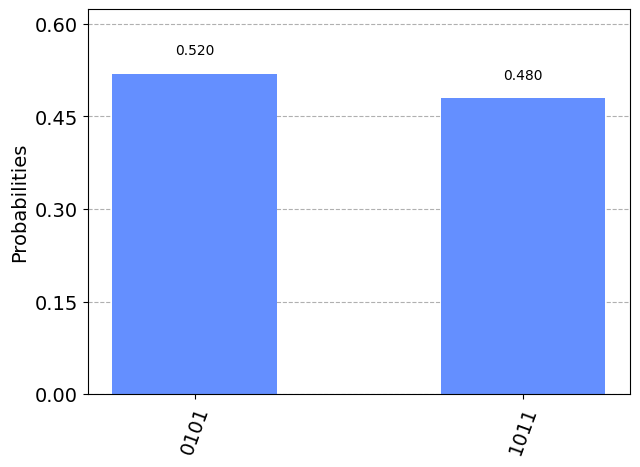

In [28]:
# 実行してみましょう。そして結果を確かめてみましょう。
aer_sim = Aer.get_backend('aer_simulator')
transpiled_qc = transpile(qc, aer_sim)
qobj = assemble(transpiled_qc)
job = aer_sim.run(qobj)
hist = job.result().get_counts()
plot_histogram(hist)

In [29]:
qiskit_quantum_counting = qiskit.compiler.transpile(qc, basis_gates=['u1','u2','u3','cx'])
f = open('quatum_counting.qasm', 'w')
f.write(qiskit_quantum_counting.qasm())
f.close()

In [31]:
input_circuit =QuantumCircuit.from_qasm_file('quatum_counting.qasm')
#input_circuit.draw()

In [32]:
!ouqu-tp trance trance --input-qasm-file=quatum_counting.qasm --input-cnot-json-file=ouqu-tp/sample/created_Cnet.json >transpiled_quantum_counting.qasm

In [33]:
output_circuit =QuantumCircuit.from_qasm_file('transpiled_quantum_counting.qasm')
output_circuit.draw()

┌─────────┐┌────┐  ┌────────┐                                           »
q_0: ┤ Rz(π/2) ├┤ √X ├──┤ Rz(-π) ├───────────────────────────────────────────»
     └──┬────┬─┘└────┘  └────────┘                                           »
q_1: ───┤ √X ├─────────────────────────────────────■─────────────────────────»
     ┌──┴────┴─┐┌────┐ ┌─────────┐               ┌─┴─┐                       »
q_2: ┤ Rz(π/2) ├┤ √X ├─┤ Rz(π/2) ├─────────■─────┤ X ├──────────■─────────■──»
     ├─────────┤├────┤┌┴─────────┴┐┌────┐  │  ┌──┴───┴──┐       │         │  »
q_3: ┤ Rz(π/2) ├┤ √X ├┤ Rz(-3π/4) ├┤ √X ├──┼──┤ Rz(π/2) ├──■────┼─────────┼──»
     └─────────┘└────┘└───────────┘└────┘  │  └─────────┘┌─┴─┐  │         │  »
q_4: ──────────────────────────────────────┼─────────────┤ X ├──┼─────────┼──»
        ┌────┐                           ┌─┴─┐           └───┘┌─┴─┐     ┌─┴─┐»
q_5: ───┤ √X ├───────────────────────────┤ X ├────────────────┤ X ├──■──┤ X ├»
        └────┘                           └───┘                └───┘  │  └───┘»
q_6: ────────────────────────────────────────────────────────────────┼───────»
        ┌────┐                                                       │       »
q_7: ───┤ √X ├───────────────────────────────────────────────────────┼───────»
        ├────┤                                                     ┌─┴─┐     »
q_8: ───┤ √X ├─────────────────────────────────────────────────────┤ X ├─────»
        └────┘                                                     └───┘     »
«                                                                     »
«q_0: ────────────────────────────────────────────────────────────────»
«          ┌───────────┐┌────┐┌───────┐                         ┌────┐»
«q_1: ──■──┤ Rz(-3π/4) ├┤ √X ├┤ Rz(π) ├──■───────────────────■──┤ √X ├»
«     ┌─┴─┐└───────────┘└────┘└───────┘┌─┴─┐               ┌─┴─┐└────┘»
«q_2: ┤ X ├──────■────────────────■────┤ X ├──■─────────■──┤ X ├──■───»
«     └───┘      │                │    └───┘  │         │  └───┘  │   »
«q_3: ───────────┼────────────────┼───────────┼─────────┼─────────┼───»
«                │                │           │         │         │   »
«q_4: ───────────┼────────────────┼───────────┼─────────┼─────────┼───»
«              ┌─┴─┐            ┌─┴─┐       ┌─┴─┐     ┌─┴─┐     ┌─┴─┐ »
«q_5: ─────────┤ X ├──────■─────┤ X ├───────┤ X ├──■──┤ X ├─────┤ X ├─»
«              └───┘      │     └───┘       └───┘  │  └───┘     └───┘ »
«q_6: ────────────────────┼────────────────────────┼──────────────────»
«                         │                        │                  »
«q_7: ────────────────────┼────────────────────────┼──────────────────»
«                       ┌─┴─┐   ┌────┐           ┌─┴─┐                »
«q_8: ──────────────────┤ X ├───┤ √X ├───────────┤ X ├────────────────»
«                       └───┘   └────┘           └───┘                »
«                                                                           »
«q_0: ──────────────────────────────────────────────────────────────────────»
«     ┌──────────┐                              ┌───────────┐┌────┐┌───────┐»
«q_1: ┤ Rz(-π/4) ├───────■───────────────────■──┤ Rz(-3π/4) ├┤ √X ├┤ Rz(π) ├»
«     └──────────┘     ┌─┴─┐               ┌─┴─┐└───────────┘└────┘└───────┘»
«q_2: ──────────────■──┤ X ├──■─────────■──┤ X ├──────■────────────────■────»
«                   │  └───┘  │         │  └───┘      │                │    »
«q_3: ──────────────┼─────────┼─────────┼─────────────┼────────────────┼────»
«                   │         │         │             │                │    »
«q_4: ──────────────┼─────────┼─────────┼─────────────┼────────────────┼────»
«                 ┌─┴─┐     ┌─┴─┐     ┌─┴─┐         ┌─┴─┐            ┌─┴─┐  »
«q_5: ─────■──────┤ X ├─────┤ X ├──■──┤ X ├─────────┤ X ├──────■─────┤ X ├──»
«          │      └───┘     └───┘  │  └───┘         └───┘      │     └───┘  »
«q_6: ─────┼───────────────────────┼───────────────────────────┼────────────»
«          │                       │        